In [ ]:
!mkdir ~\.kaggle

In [ ]:
!cd ~\.kaggle && ls

In [ ]:
!kaggle competitions download -c petfinder-pawpularity-score

In [1]:
#import tensorflow as tf
#gpus = tf.config.list_physical_devices('GPU')
#if gpus:
#  try:
#    # Currently, memory growth needs to be the same across GPUs
#    for gpu in gpus:
#      tf.config.experimental.set_memory_growth(gpu, True)
#    logical_gpus = tf.config.list_logical_devices('GPU')
#    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
#  except RuntimeError as e:
#    # Memory growth must be set before GPUs have been initialized
#    print(e)
    

In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [3]:
#import af libaries
import tensorflow as tf
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import tensorflow_addons as tfa
from PIL import Image
import imagehash
import imageio
import random
from tqdm.notebook import tqdm
from sklearn.model_selection import train_test_split
from tensorflow.keras import layers



In [80]:
#test is not working i need to have a look at the download again
train = pd.read_csv('train.csv')
#test = pd.read_csv('test.csv')
print("Amount of tranning's data: " + str(len(train)))
#print("Amount of test data: " + str(len(test)))

#Image size we use atm we need to change it to a ratio of .9 since that is the mean
image_size = 224 



Amount of tranning's data: 9912


In [5]:
#Loading images
def get_train_file_path(image_id):
    return r"C:\Users\tobia\Documents\GitHub\PetFinder\train\{}.jpg".format(image_id)

def get_test_file_path(image_id):
    return r"C:\Users\tobia\Documents\GitHub\PetFinder\test\{}.jpg".format(image_id)

train['file_path'] = train['Id'].apply(get_train_file_path)
#test['file_path'] = test['Id'].apply(get_test_file_path)


# Shows the first 5, change the paramter for more
display(train.head())


,Id,Subject Focus,Eyes,Face,Near,Action,Accessory,Group,Collage,Human,Occlusion,Info,Blur,Pawpularity,file_path
0,0007de18844b0dbbb5e1f607da0606e0,0,1,1,1,0,0,1,0,0,0,0,0,63,C:\Users\tobia\Documents\GitHub\PetFinder\trai...
1,0009c66b9439883ba2750fb825e1d7db,0,1,1,0,0,0,0,0,0,0,0,0,42,C:\Users\tobia\Documents\GitHub\PetFinder\trai...
2,0013fd999caf9a3efe1352ca1b0d937e,0,1,1,1,0,0,0,0,1,1,0,0,28,C:\Users\tobia\Documents\GitHub\PetFinder\trai...
3,0018df346ac9c1d8413cfcc888ca8246,0,1,1,1,0,0,0,0,0,0,0,0,15,C:\Users\tobia\Documents\GitHub\PetFinder\trai...
4,001dc955e10590d3ca4673f034feeef2,0,0,0,1,0,0,1,0,0,0,0,0,72,C:\Users\tobia\Documents\GitHub\PetFinder\trai...


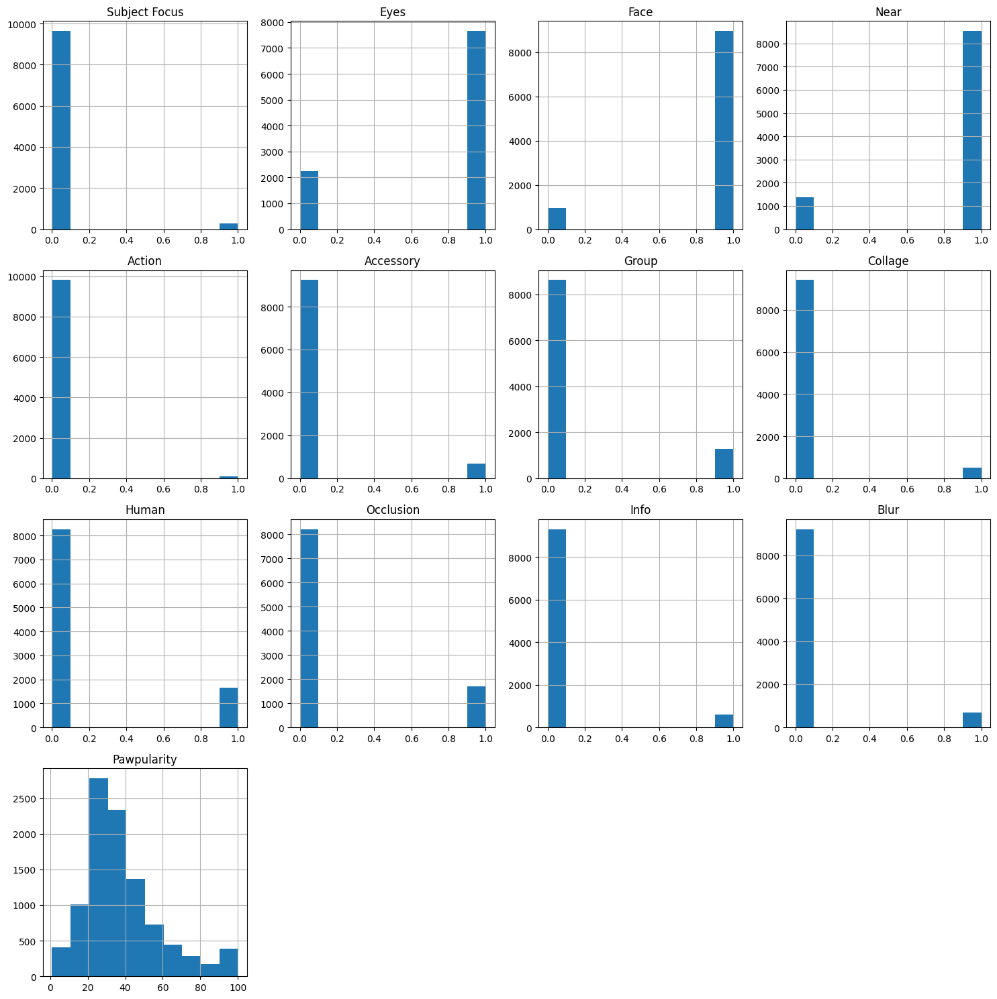

In [6]:
#Visualizing the spread??
train.hist(figsize=(15,15))
plt.tight_layout()
plt.show()

In [ ]:
#Mean of Pawpularity remove [] if you want the see mean on everything
print("Mean value of train "+ str(train['Pawpularity'].mean()))
train.info()

In [ ]:
#Kinda slow might be a faster way to do it.
#It gets height and width of each image and then calculate the aspect ratio
widths = []
heights = []
ratios = []
for file_path in tqdm(train['file_path']):
    image = imageio.imread(file_path)
    h, w, _ = image.shape
    heights.append(h)
    widths.append(w)
    ratios.append(w / h)

In [ ]:
#First we plot it to see the values
plt.figure(figsize=(15,8))
plt.title(f'Height and Width', size=24)
plt.hist(heights, bins=32, label='Heights')
plt.hist(widths, bins=32, label='Widths')
plt.legend(prop={'size': 16})
plt.show()

In [ ]:
#https://www.kaggle.com/markwijkhuizen/petfinder-eda-yolov5-obj-detection-tfrecords#Image-EDA
#Fyld ud med grå
display(pd.Series(ratios).describe())
plt.figure(figsize=(15,8))
plt.title(f'Ratios', size=24)
plt.hist(ratios, bins=15, label='Ratios')
plt.legend(prop={'size': 15})
plt.show()

In [ ]:
#Hard to see the coalition on the ???bar??? graph so we create a scatter point graph
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111)
points = ax.scatter(widths, heights, color='blue', alpha=0.5, s=ratios, picker=True)
ax.set_title("Image Resolution")
ax.set_xlabel("Width", size=14)
ax.set_ylabel("Height", size=14)

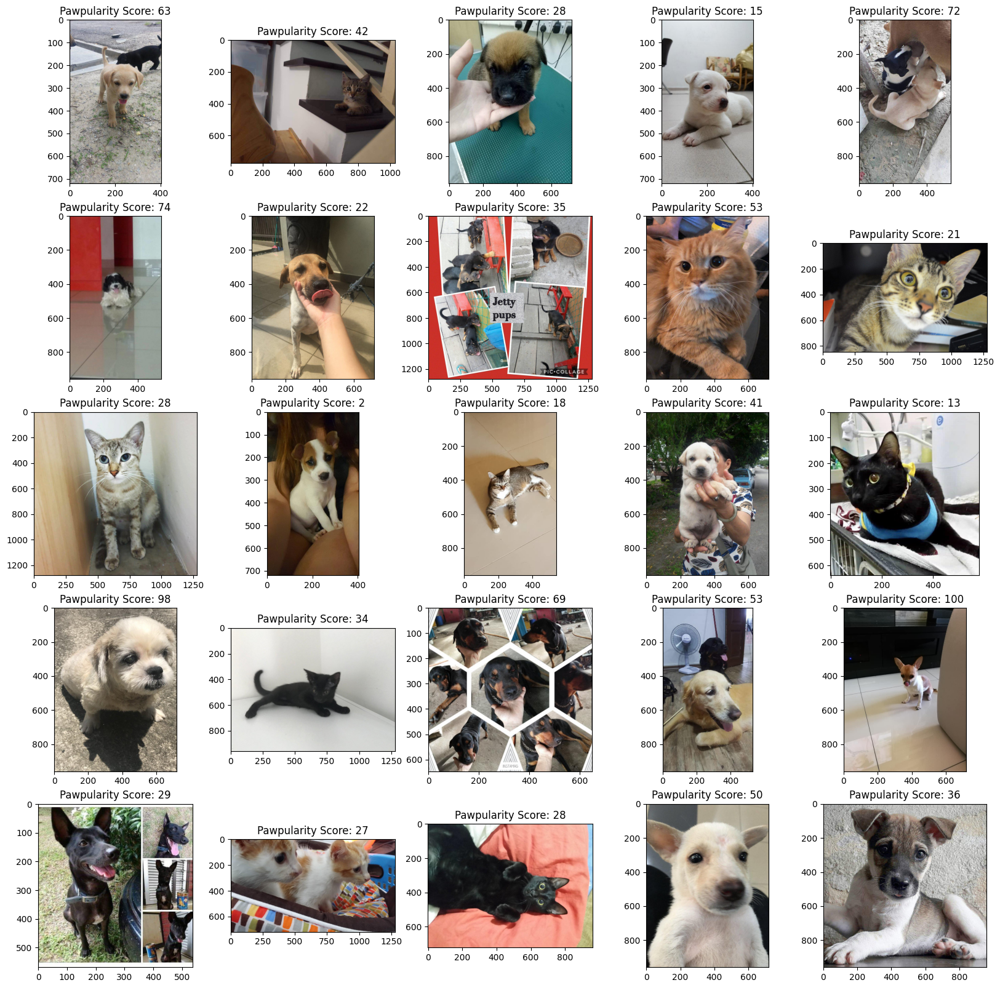

In [7]:
#Shows 5x5 images and their title is their paw score
plt.figure(figsize=(20, 20))
for i in range(5 * 5):
    plt.subplot(5, 5, i+1)
    image = plt.imread(train.iloc[i, -1])
    Pawpularity = train.iloc[i, -2]
    plt.imshow(image)
    plt.title(f"Pawpularity Score: {Pawpularity}")
plt.show()

In [ ]:
#ligner der er duplicates som skal fjernes 
#https://www.kaggle.com/c/petfinder-pawpularity-score/discussion/278497 kode til at fjerne dem findes her
tqdm.pandas()
def get_hash(file_path):
    img = Image.open(file_path)
    img_hash = imagehash.phash(img)
    
    return img_hash.hash.reshape(-1).astype(np.uint8)
    
train['phash'] = train['file_path'].progress_apply(get_hash)

In [ ]:
def find_similar_images(threshold=0.90):
    # Number of Duplicate Images Found
    duplicate_counter = 1
    # Indices of Duplicate Images
    duplicate_idxs = set()
    # For each image in the train dataset
    for idx, phash in enumerate(tqdm(train['phash'])):
        # Compute the similarity to all other images
        for idx_other, phash_other in enumerate(train['phash']):
            # Similarity score is imply the percentage of equal bits
            similarity = (phash ==phash_other).mean()
            # Prevent self comparison, threshold similarity and ignore repetetive duplicate detection
            if idx != idx_other and similarity > threshold and not(duplicate_idxs.intersection([idx, idx_other])):
                # Update Duplicate Indices
                duplicate_idxs.update([idx, idx_other])
                # Get DataFrame rows
                row = train.loc[idx]
                row_other = train.loc[idx_other]
                # Plot Duplicate Images
                fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(8,5))
                ax[0].imshow(imageio.imread(row['file_path']))
                ax[0].set_title(f'Idx: {idx}, Pawpularity: {row["Pawpularity"]}')
                ax[1].imshow(imageio.imread(row_other['file_path']))
                ax[1].set_title(f'Idx: {idx_other}, Pawpularity: {row_other["Pawpularity"]}')
                plt.suptitle(f'{duplicate_counter} | PHASH Similarity: {similarity:.3f}')
                plt.show()
                # Increase Duplicate Counter
                duplicate_counter += 1
                
    # Return Indices of Duplicates
    return duplicate_idxs
    
duplicate_idxs = find_similar_images()
#The same images don't have the same paw score. The majority's paw score's diffrence is around 10.
#But some got over double the score'

In [ ]:
print(f'Found {len(duplicate_idxs)} Duplicate Images')
# Removing Duplicate Images, 
#Code taken from https://www.kaggle.com/markwijkhuizen/petfinder-eda-yolov5-obj-detection-tfrecords#Image-EDA
#IMPORTANT(I think so atleast)! If this code is run twice it will drop both images instead of just one of the duplicates
#Hhich image is correct one? They got diffrent scores
train = train.drop(duplicate_idxs).reset_index(drop=True)
print("Amount of tranning's data: " + str(len(train)))

In [22]:
# Shows a batch of images we will use this function to see the lowest and highest pawpularity
#no longer works when we call it here no idea why. So i just moved it out of a function and then it worked
def show_batch_df(df):
    plt.figure(figsize=(20, 20))
    for i in range(5 * 5):
        plt.subplot(5, 5, i+1)
        image = plt.imread(df.iloc[i, -1])
        Pawpularity = df.iloc[i, -2]
        plt.imshow(image)
        plt.title(f"Pawpularity Score: {Pawpularity}")
    plt.show()


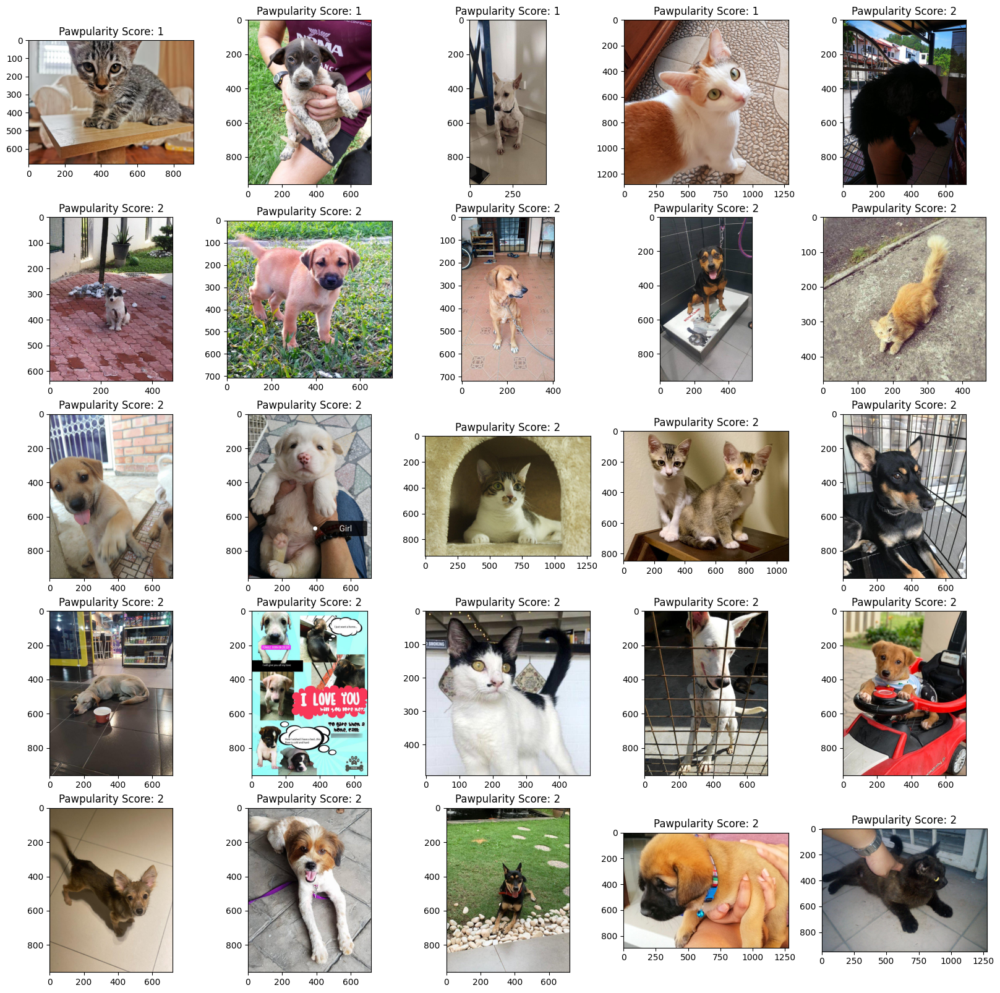

In [32]:
#Images with the lowest value
sorted_lowest = (train.sort_values('Pawpularity'))
plt.figure(figsize=(20, 20))
for i in range(5 * 5):
    plt.subplot(5, 5, i+1)
    image = plt.imread(sorted_lowest.iloc[i, -1])
    Pawpularity = sorted_lowest.iloc[i, -2]
    plt.imshow(image)
    plt.title(f"Pawpularity Score: {Pawpularity}")
plt.show()

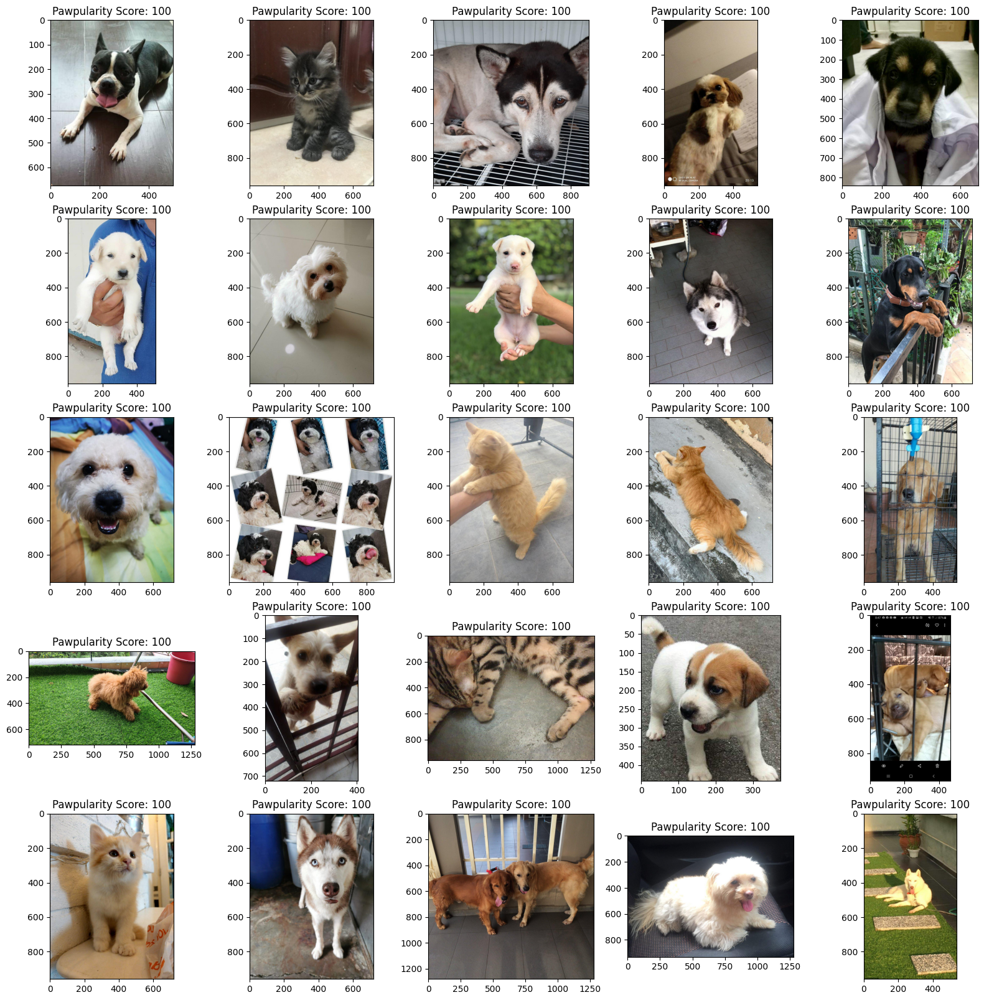

In [36]:
#Images with the highest value
sorted_highest = (train.sort_values('Pawpularity',ascending=False))
plt.figure(figsize=(20, 20))
for i in range(5 * 5):
    plt.subplot(5, 5, i+1)
    image = plt.imread(sorted_highest.iloc[i, -1])
    Pawpularity = sorted_highest.iloc[i, -2]
    plt.imshow(image)
    plt.title(f"Pawpularity Score: {Pawpularity}")
plt.show()

In [37]:
#We need some more preproccsing and data normalization
def dataNormalization(image):
    image = Image.open(image)
    #tf.image.convert_image_dtype(image, tf.float32)
    image_size = 224
    #image = tf.reshape(image, [352, 352, 3])
    image = tf.image.resize(image, (image_size, image_size))
    image = tf.cast(image, tf.float32) / 255.0
    return image

In [38]:
#train['file_path'] = train['file_path'].apply(dataNormalization)
#image = plt.imread(train.loc[0,'file_path'])
#ds = tf.data.Dataset.from_tensor_slices(dict(train))
AUTOTUNE = tf.data.experimental.AUTOTUNE

#opdel i test og train
train, test = train_test_split(train, test_size=0.2)
print("Amount of tranning's data: " + str(len(train)))
print("Amount of test data: " + str(len(test)))

train_dataset = train['file_path'].map(dataNormalization)
test_dataset = test['file_path'].map(dataNormalization)


Amount of tranning's data: 7929
Amount of test data: 1983


In [40]:
#checks if the values are normalized
print(train_dataset[0])
#we need proper names here
train_pred = train.loc[:,'Pawpularity']
test_pred = test.loc[:,'Pawpularity']


tf.Tensor(
[[[0.4459987  0.42330962 0.47821158]
  [0.4569118  0.43422273 0.48912472]
  [0.35909083 0.33640173 0.3913037 ]
  ...
  [0.7024811  0.7138256  0.77153766]
  [0.70247006 0.717316   0.7643748 ]
  [0.6886921  0.703538   0.7505968 ]]

 [[0.6384897  0.62280345 0.6777054 ]
  [0.6118178  0.5961315  0.65103346]
  [0.69509244 0.67940617 0.7343081 ]
  ...
  [0.7213425  0.7252641  0.73842937]
  [0.722549   0.7264706  0.7396359 ]
  [0.70598686 0.7099084  0.7230736 ]]

 [[0.7190917  0.7112486  0.76222897]
  [0.7011314  0.69328827 0.74426866]
  [0.70741516 0.699572   0.7505524 ]
  ...
  [0.68615806 0.6866745  0.70375115]
  [0.6576698  0.65794986 0.6754569 ]
  [0.6675887  0.6678688  0.6853758 ]]

 ...

 [[0.61200607 0.59660035 0.5806335 ]
  [0.5003388  0.48493305 0.46896625]
  [0.47401822 0.4583319  0.4465672 ]
  ...
  [0.75136316 0.7474416  0.7317553 ]
  [0.7741789  0.77025735 0.7545711 ]
  [0.78357774 0.7796562  0.7639699 ]]

 [[0.62320566 0.5918331  0.58399   ]
  [0.6180578  0.59844995 0

In [41]:
#print(test_pred)
#type(pred)
#result = pd.merge(train_dataset, pred, left_on=None)
train_dataset = pd.merge(train_dataset, train_pred, left_index=True, right_index=True)
test_dataset = pd.merge(test_dataset, test_pred, left_index=True, right_index=True)

In [42]:
print(train_dataset.loc[0, 'file_path'])

tf.Tensor(
[[[0.4459987  0.42330962 0.47821158]
  [0.4569118  0.43422273 0.48912472]
  [0.35909083 0.33640173 0.3913037 ]
  ...
  [0.7024811  0.7138256  0.77153766]
  [0.70247006 0.717316   0.7643748 ]
  [0.6886921  0.703538   0.7505968 ]]

 [[0.6384897  0.62280345 0.6777054 ]
  [0.6118178  0.5961315  0.65103346]
  [0.69509244 0.67940617 0.7343081 ]
  ...
  [0.7213425  0.7252641  0.73842937]
  [0.722549   0.7264706  0.7396359 ]
  [0.70598686 0.7099084  0.7230736 ]]

 [[0.7190917  0.7112486  0.76222897]
  [0.7011314  0.69328827 0.74426866]
  [0.70741516 0.699572   0.7505524 ]
  ...
  [0.68615806 0.6866745  0.70375115]
  [0.6576698  0.65794986 0.6754569 ]
  [0.6675887  0.6678688  0.6853758 ]]

 ...

 [[0.61200607 0.59660035 0.5806335 ]
  [0.5003388  0.48493305 0.46896625]
  [0.47401822 0.4583319  0.4465672 ]
  ...
  [0.75136316 0.7474416  0.7317553 ]
  [0.7741789  0.77025735 0.7545711 ]
  [0.78357774 0.7796562  0.7639699 ]]

 [[0.62320566 0.5918331  0.58399   ]
  [0.6180578  0.59844995 0

In [43]:
display(train_dataset.head())

#print(train_dataset['file_path'])
#display(result.head())

,file_path,Pawpularity
7674,"(((tf.Tensor(0.20408162, shape=(), dtype=float...",3
9520,"(((tf.Tensor(0.15211804, shape=(), dtype=float...",2
8743,"(((tf.Tensor(1.0, shape=(), dtype=float32), tf...",22
1025,"(((tf.Tensor(0.17231268, shape=(), dtype=float...",30
7865,"(((tf.Tensor(0.70268106, shape=(), dtype=float...",30


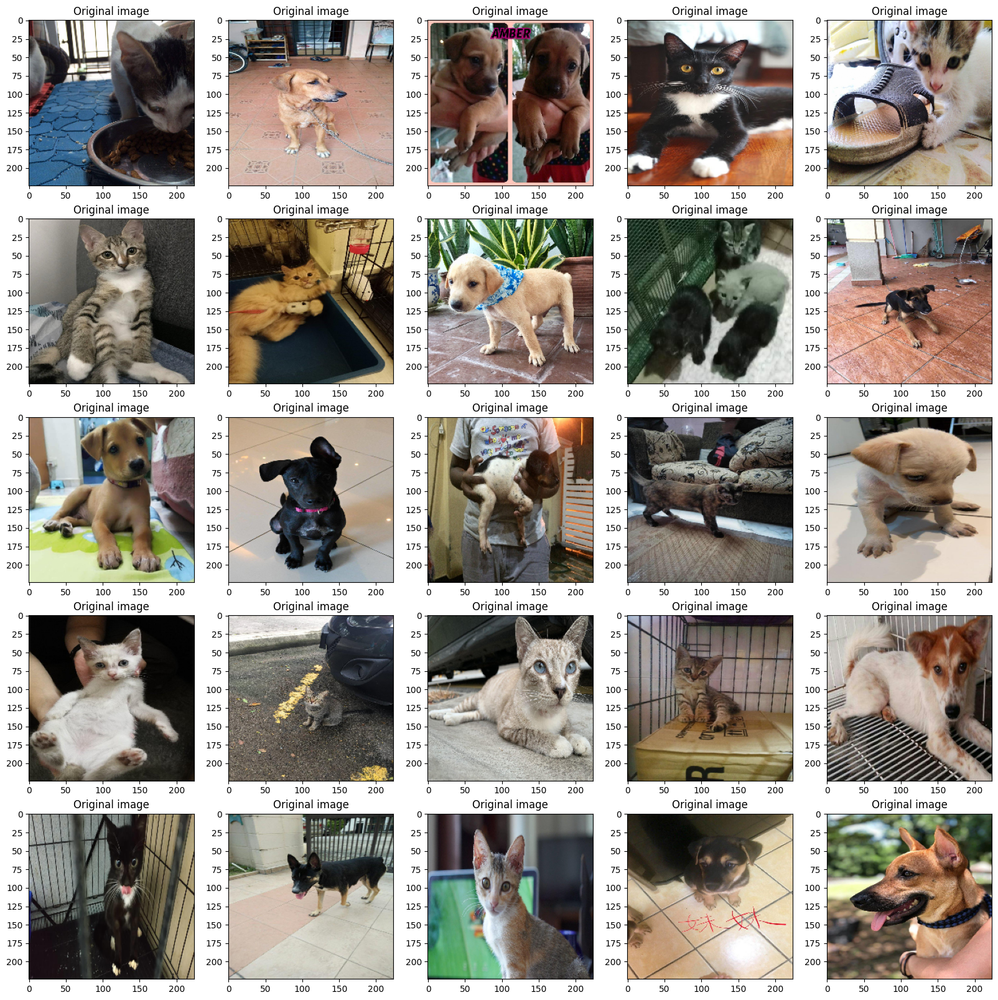

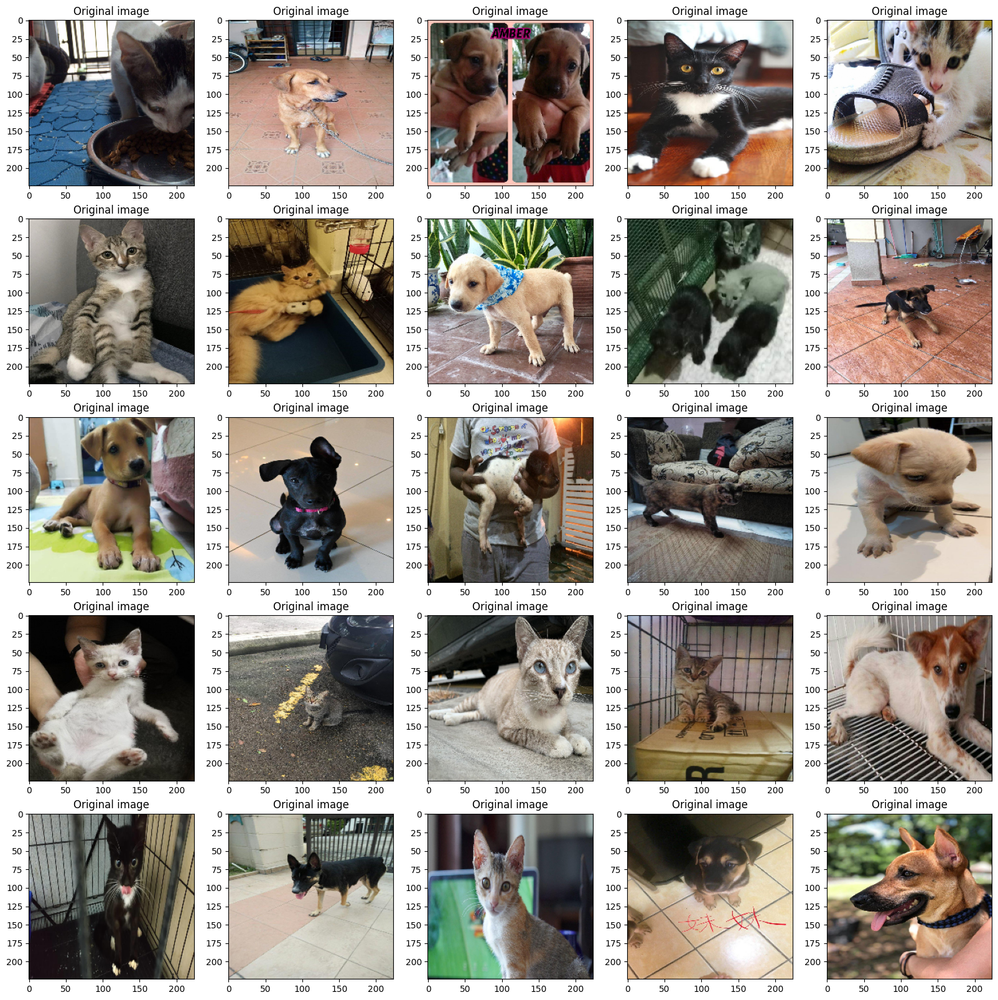

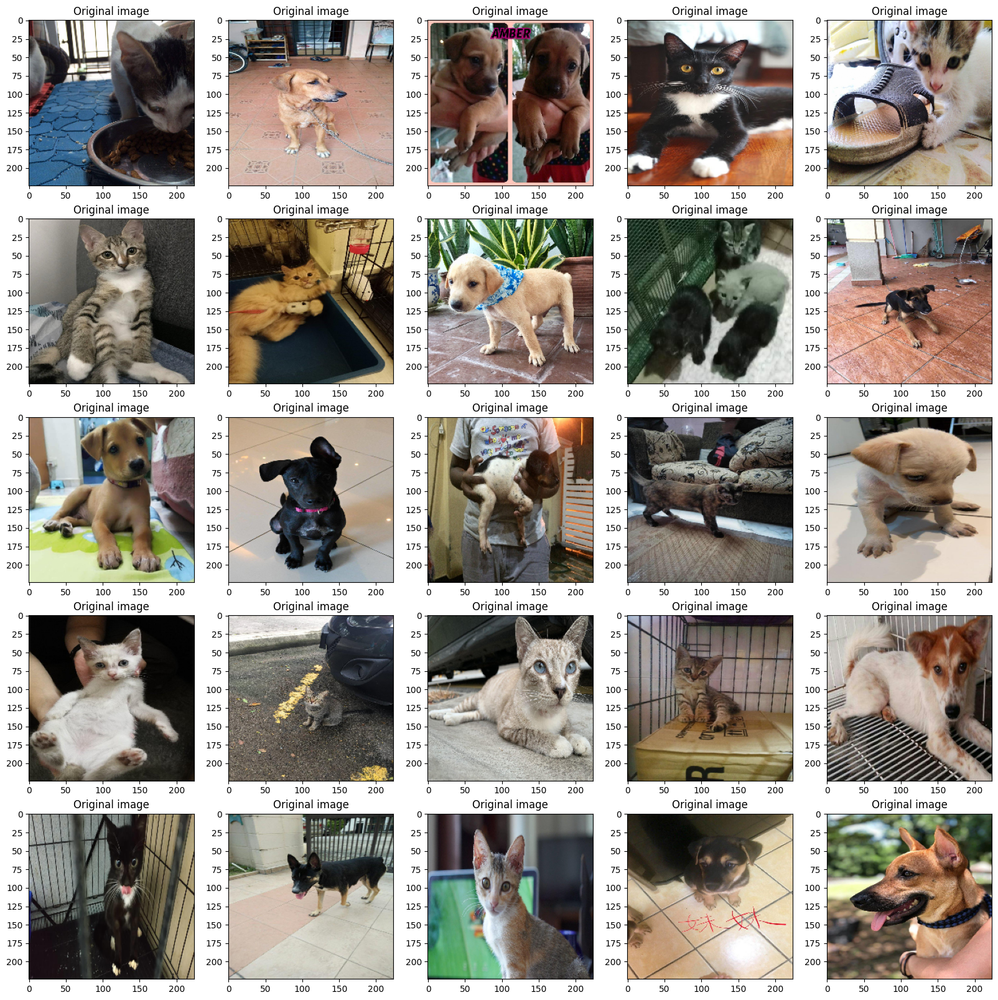

In [46]:
plt.figure(figsize=(20, 20))
for i in range(5 * 5):
    plt.subplot(5, 5, i+1)
    plt.title('Original image')
    image = train_dataset.iloc[i, 0]
    plt.imshow(image)
plt.show(block=False)


In [55]:
def augment(augmented):
    # We need to test with the diffrent type of augment to see if they hurt the acc. 
    # We should also take some of the fuctions we used in CNN
    augmented = tf.image.random_brightness(augmented, 0.05)
    augmented = tf.image.random_flip_left_right(augmented)
    augmented = tf.image.random_saturation(augmented, 0.95, 1)
    augmented = tf.image.random_contrast(augmented, 0.95, 1)
    augmented = tf.image.random_hue(augmented, 0.05)
    augmented = shear(augmented)
    return augmented

def visualize(original, augmented):
    fig = plt.figure()
    plt.subplot(1,2,1)
    plt.title('Original image')
    plt.imshow(original)

    plt.subplot(1,2,2)
    plt.title('Augmented image')
    plt.imshow(augmented)


def shear(image):
    #shear
    #de her værdier skal nok ændres i
    random_number_shear = random.uniform(-0.2,0.2)
    shear = random_number_shear
    shear_rotate = shear * -20
    image = tfa.image.transform(image, [1.0, shear, shear_rotate, 0.0, 1.0, 0.0, 0.0, 0.0])
    return image

def crop(image):
    # Add 6 pixels of padding
    image = tf.image.resize_with_crop_or_pad(image, img_height + 6, img_width + 6) 
    # Random crop back to the original size
    image = tf.image.random_crop(image, size=[img_height, img_width, 1])
    return image

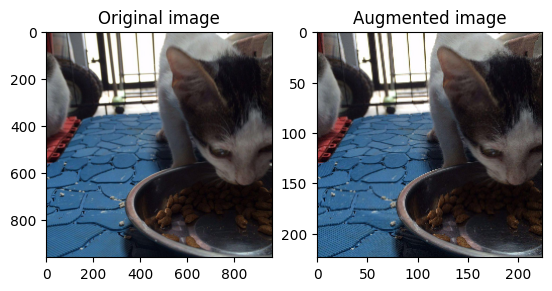

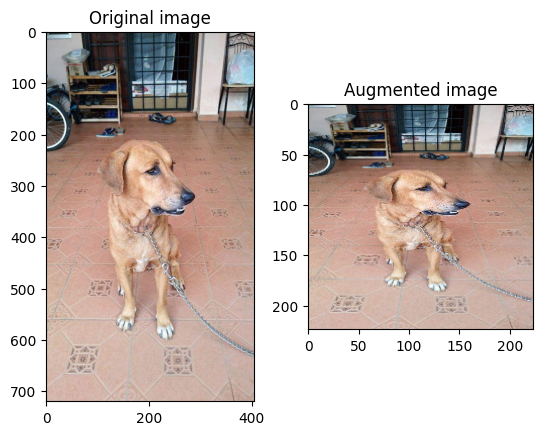

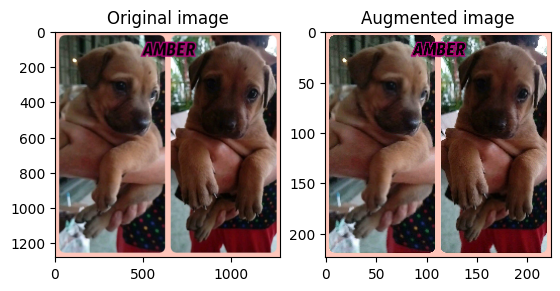

In [66]:
#Side by side comparrison with the new ratio
for i in range(3):
    result_image = train_dataset.iloc[i, 0]
    train_image = plt.imread(train.iloc[i, -1])
    visualize(train_image,result_image)
plt.show(block=False)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


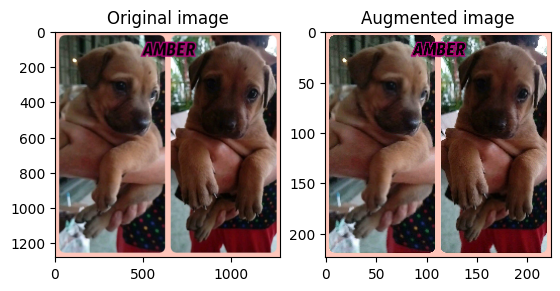

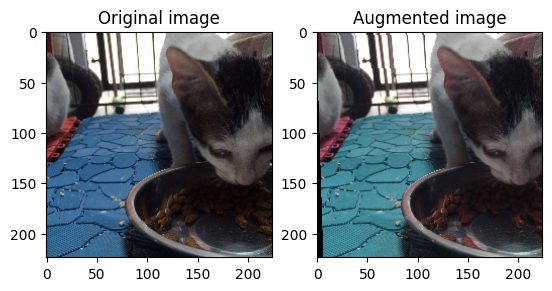

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


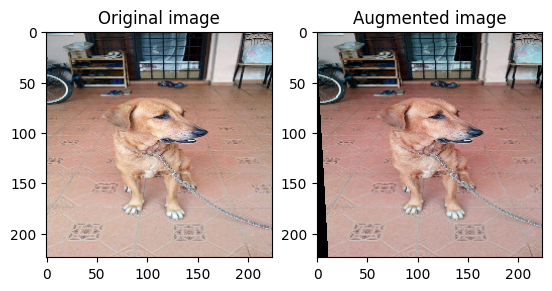

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


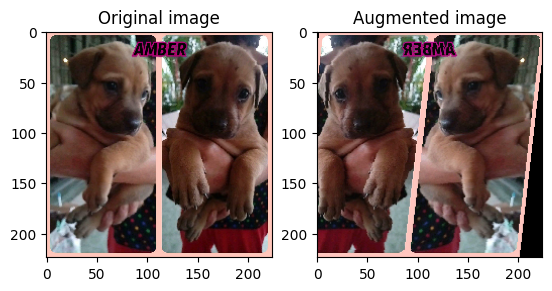

In [62]:
for i in range(3):
    image = train_dataset.iloc[i, 0]
    changed_image = augment(image)
    visualize(image,changed_image)
    plt.show(block=False)


In [79]:
#First model
model = tf.keras.models.Sequential([
layers.Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=[image_size, image_size, 3]),
layers.Conv2D(filters=64, kernel_size=3, activation='relu'),
layers.MaxPool2D(pool_size=2, strides=2),
layers.Dropout(0.25),
layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
layers.MaxPool2D(pool_size=2, strides=2),
layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
layers.MaxPool2D(pool_size=2, strides=2),
layers.Dropout(0.25),
layers.Flatten(),
layers.Dense(units=1024, activation='relu'),
layers.Dropout(0.50),
layers.Dense(units=1,activation='softmax')
])

model.compile(
  optimizer='adam',
  loss=tf.losses.SparseCategoricalCrossentropy(from_logits=False),
  metrics=['accuracy'])

NameError: name 'image_size' is not defined

In [76]:
print(train_dataset.shape)
print(test_dataset.shape)
#print(test_dataset)
#df[df['price'] < 50000]
#https://www.kaggle.com/questions-and-answers/50121

#try this df["Code"]= np.where(df["Total Time"]<6.00,1,df["Code"])

train_dataset.loc[(train_dataset["Pawpularity"]<=100)|train_dataset["Pawpularity"]>0]
test_dataset.loc[(test_dataset["Pawpularity"]<=100)|test_dataset["Pawpularity"]>0]
#x_tensor = tf.convert_to_tensor(train_dataset, dtype=tf.int64) 
#train_dataset=np.asarray(train_dataset).astype(np.float32)

#intet virker og jeg er trist
#We need to batch the data aswell!

(7929, 2)
(1983, 2)


,file_path,Pawpularity
8298,"(((tf.Tensor(0.6166467, shape=(), dtype=float3...",31
3345,"(((tf.Tensor(0.8392157, shape=(), dtype=float3...",46
2555,"(((tf.Tensor(0.7764706, shape=(), dtype=float3...",12
9746,"(((tf.Tensor(0.12647308, shape=(), dtype=float...",14
2420,"(((tf.Tensor(0.3708057, shape=(), dtype=float3...",47
...,...,...
6435,"(((tf.Tensor(0.97435975, shape=(), dtype=float...",54
7201,"(((tf.Tensor(0.15390843, shape=(), dtype=float...",35
6876,"(((tf.Tensor(0.78030217, shape=(), dtype=float...",3
4321,"(((tf.Tensor(0.66848737, shape=(), dtype=float...",26


In [70]:
history = model.fit(train_dataset, epochs = 1)
#fit(
#    x=None, y=None, batch_size=None, epochs=1, verbose='auto',
#    callbacks=None, validation_split=0.0, validation_data=None, shuffle=True,
#    class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None,
#    validation_steps=None, validation_batch_size=None, validation_freq=1,
#    max_queue_size=10, workers=1, use_multiprocessing=False
#)



#, validation_data = test_dataset virker ikke

ValueError: Failed to convert a NumPy array to a Tensor (Unsupported object type tensorflow.python.framework.ops.EagerTensor).

In [77]:
model.summary()

ValueError: This model has not yet been built. Build the model first by calling `build()` or calling `fit()` with some data, or specify an `input_shape` argument in the first layer(s) for automatic build.